# Instalacja detectronu 2

In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-1bv756_o
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-1bv756_o
     |████████████████████████████████| 636 kB 5.4 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5-py3-none-any.whl size=64553 sha256=4920e9f3abb7e634d62887aad7103b36937ffd96dfe3f92868adec6c9104de12
  Stored in directory: /tmp/pip-ephem-wheel-cache-oe72l6f0/wheels/24/1d/09/8167de727fe5b74f832b6fcb5d9069d8f03ca29f337bfe484d
Successfully built fvcore
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


'1.9.0+cu102'

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 13028, done.
remote: Counting objects: 100% (529/529), done.
remote: Compressing objects: 100% (255/255), done.
remote: Total 13028 (delta 307), reused 436 (delta 270), pack-reused 12499
Receiving objects: 100% (13028/13028), 5.59 MiB | 15.63 MiB/s, done.
Resolving deltas: 100% (9255/9255), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 74 kB 1.9 MB/s 
     |████████████████████████████████| 145 kB 11.2 MB/s 
     |████████████████████████████████| 130 kB 38.6 MB/s 
     |████████████████████████████████| 743 kB 46.2 MB/s 
     |████████████████████████████████| 745 kB 24.8 MB/s 
     |████████████████████████████████| 112 kB 42.3 MB/s 
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=7bbf92f118d540a0a91281cfc5e7777054174782b516fce52e5be560bd417781
  Stored in directory: /root/.cache/pip/wheels/ca/33/b7/336836125fc9bb

Przed uruchomieniem komórek poniżej należy uruchomić ponownie środowisko wykonawcze

## Import bibliotek

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import random
import tqdm
import os


from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data.datasets import register_coco_instances


## Ściagnięcie oraz rejestracja własnych datasetów w formacie COCO



In [ ]:
!gdown --id 1c5vXk-WL75t8xHXB9Wj8nZoFzAg7YCBl
!gdown --id 1ajodZ943qLLd0rR31g4pD99tkQNMatVF
!unzip volleyball_difficult.zip
!unzip volleyball_easy.zip

Downloading...
From: https://drive.google.com/uc?id=1c5vXk-WL75t8xHXB9Wj8nZoFzAg7YCBl
To: /content/volleyball_easy.zip
39.3MB [00:00, 69.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ajodZ943qLLd0rR31g4pD99tkQNMatVF
To: /content/volleyball_difficult.zip
98.3MB [00:00, 119MB/s] 
Archive:  volleyball_difficult.zip
   creating: volleyball_difficult/
   creating: volleyball_difficult/test/
  inflating: volleyball_difficult/test/VID_20200914_223523-003_jpg.rf.7be0c2e2d1ab6a8357324ed8da6b3023.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-009.rf.704d547ecf12e7c7d32143728be702cc.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-025.rf.1064ee05f5dfc5d52f89011fc3a764a1.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-025_jpg.rf.526c554290e87bf6a6c81ede03206b63.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-027.rf.ef9fcf26c60675ba23f7721dcbc1757e.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-028.r

In [ ]:
register_coco_instances("volleyball_easy_train", {}, "/content/volleyball_easy/train/_annotations.coco.json", "/content/volleyball_easy/train")
register_coco_instances("volleyball_easy_test", {}, "/content/volleyball_easy/test/_annotations.coco.json", "/content/volleyball_easy/test")
register_coco_instances("volleyball_difficult_train", {}, "/content/volleyball_difficult/train/_annotations.coco.json", "/content/volleyball_difficult/train")
register_coco_instances("volleyball_difficult_test", {}, "/content/volleyball_difficult/test/_annotations.coco.json", "/content/volleyball_difficult/test")

In [ ]:
volleyball_easy_train_metadata = MetadataCatalog.get("volleyball_easy_train")
dataset_dicts = DatasetCatalog.get("volleyball_easy_train")
volleyball_easy_test_metadata = MetadataCatalog.get("volleyball_easy_test")
dataset_dicts2 = DatasetCatalog.get("volleyball_easy_test")
volleyball_difficult_train_metadata = MetadataCatalog.get("volleyball_difficult_train")
dataset_dicts3 = DatasetCatalog.get("volleyball_difficult_train")
volleyball_difficult_test_metadata = MetadataCatalog.get("volleyball_difficult_test")
dataset_dicts4 = DatasetCatalog.get("volleyball_difficult_test")

print(volleyball_easy_train_metadata)
print(volleyball_easy_test_metadata)
print(volleyball_difficult_train_metadata)
print(volleyball_difficult_test_metadata)

[09/18 14:00:21 d2.data.datasets.coco]: Loaded 1200 images in COCO format from /content/volleyball_easy/train/_annotations.coco.json
[09/18 14:00:21 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/volleyball_easy/test/_annotations.coco.json
[09/18 14:00:21 d2.data.datasets.coco]: Loaded 914 images in COCO format from /content/volleyball_difficult/train/_annotations.coco.json
[09/18 14:00:21 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
Metadata(evaluator_type='coco', image_root='/content/volleyball_easy/train', json_file='/content/volleyball_easy/train/_annotations.coco.json', name='volleyball_easy_train', thing_classes=['Ball'], thing_dataset_id_to_contiguous_id={1: 0})
Metadata(evaluator_type='coco', image_root='/content/volleyball_easy/test', json_file='/content/volleyball_easy/test/_annotations.coco.json', name='volleyball_easy_test', thing_classes=['Ball'], thing_dataset_id_to_contiguou

Przykładowe zdjęcia z "łatwego" zestawu


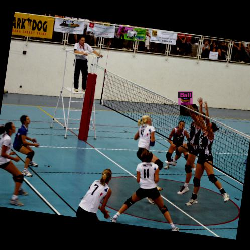

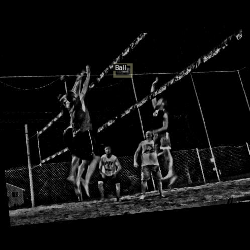

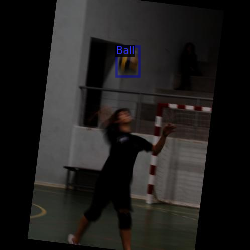

Przykładowe zdjęcia z "trudnego" zestawu


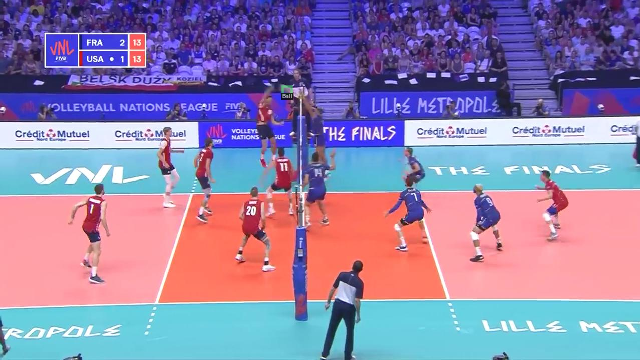

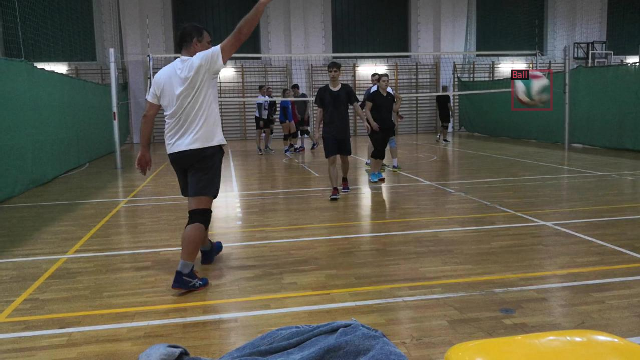

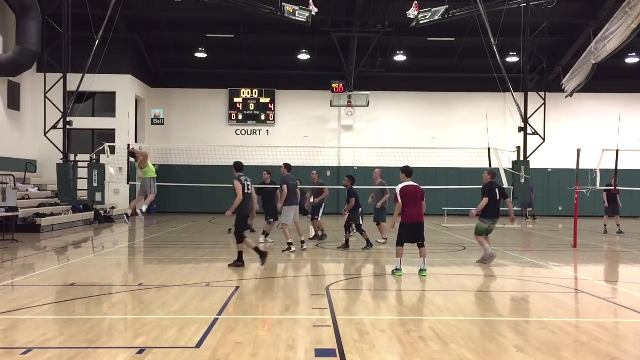

In [ ]:
print('Przykładowe zdjęcia z "łatwego" zestawu')
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=volleyball_difficult_test_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])
print('Przykładowe zdjęcia z "trudnego" zestawu')
for d in random.sample(dataset_dicts3, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=volleyball_difficult_test_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#Trenowanie modelu na "prostym" datasecie

In [ ]:
cfg = get_cfg()


In [ ]:
from pprint import pprint

pprint(cfg['MODEL']['RETINANET'])

{'BBOX_REG_LOSS_TYPE': 'smooth_l1',
 'BBOX_REG_WEIGHTS': (1.0, 1.0, 1.0, 1.0),
 'FOCAL_LOSS_ALPHA': 0.25,
 'FOCAL_LOSS_GAMMA': 2.0,
 'IN_FEATURES': ['p3', 'p4', 'p5', 'p6', 'p7'],
 'IOU_LABELS': [0, -1, 1],
 'IOU_THRESHOLDS': [0.4, 0.5],
 'NMS_THRESH_TEST': 0.5,
 'NORM': '',
 'NUM_CLASSES': 80,
 'NUM_CONVS': 4,
 'PRIOR_PROB': 0.01,
 'SCORE_THRESH_TEST': 0.05,
 'SMOOTH_L1_LOSS_BETA': 0.1,
 'TOPK_CANDIDATES_TEST': 1000}


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("volleyball_easy_train",)
cfg.DATASETS.TEST = ('volleyball_easy_test',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.005
cfg.SOLVER.MAX_ITER = 4000
cfg.MODEL.RETINANET.NUM_CLASSES = 1


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)

Loading config /content/detectron2_repo/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[09/18 14:00:32 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_5bd44e.pkl: 152MB [00:05, 25.8MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (9, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
head.cls_score.{bias, weight}
The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std


In [ ]:
trainer.train()

[09/18 14:00:40 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[09/18 14:01:11 d2.utils.events]:  eta: 1:42:35  iter: 19  total_loss: 1.113  loss_cls: 0.8179  loss_box_reg: 0.2453  time: 1.5891  data_time: 0.0335  lr: 9.9905e-05  max_mem: 1489M
[09/18 14:01:32 d2.utils.events]:  eta: 1:34:02  iter: 39  total_loss: 1.298  loss_cls: 0.8618  loss_box_reg: 0.2814  time: 1.2870  data_time: 0.0088  lr: 0.0001998  max_mem: 1489M
[09/18 14:01:49 d2.utils.events]:  eta: 1:06:43  iter: 59  total_loss: 1.4  loss_cls: 1.087  loss_box_reg: 0.2034  time: 1.1510  data_time: 0.0088  lr: 0.0002997  max_mem: 1489M
[09/18 14:02:07 d2.utils.events]:  eta: 1:00:56  iter: 79  total_loss: 0.9161  loss_cls: 0.7541  loss_box_reg: 0.194  time: 1.0780  data_time: 0.0111  lr: 0.00039961  max_mem: 1489M
[09/18 14:02:25 d2.utils.events]:  eta: 1:00:37  iter: 99  total_loss: 0.5123  loss_cls: 0.2543  loss_box_reg: 0.2055  time: 1.0439  data_time: 0.0091  lr: 0.00049951  max_mem: 1489M
[09/18 14:02:43 d2.utils.events]:  eta: 1:00:16  iter: 119  total_loss: 0.5674  loss_cls: 0.31

##Tworzenie predyktora i wizualizacja rezultatów


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5  # set the testing threshold for this model
cfg.DATASETS.TEST = ("volleyball_easy_test", )
predictor = DefaultPredictor(cfg)

{'instances': Instances(num_instances=1, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[192.1977, 152.3271, 215.0071, 175.1219]], device='cuda:0')), scores: tensor([0.8953], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


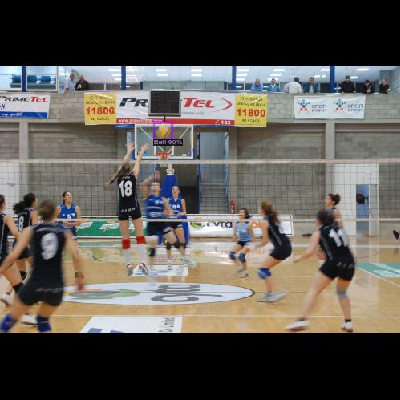

{'instances': Instances(num_instances=1, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[155.5402, 292.3429, 253.9029, 389.1980]], device='cuda:0')), scores: tensor([0.9902], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


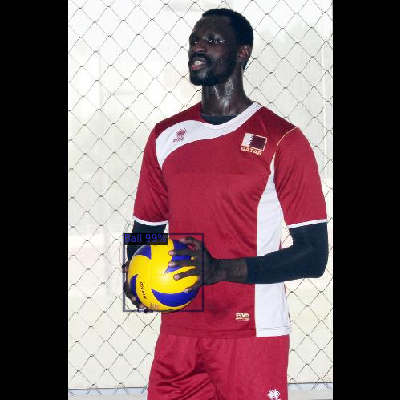

{'instances': Instances(num_instances=1, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[244.7755,  60.3288, 274.7935,  90.1909]], device='cuda:0')), scores: tensor([0.9927], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


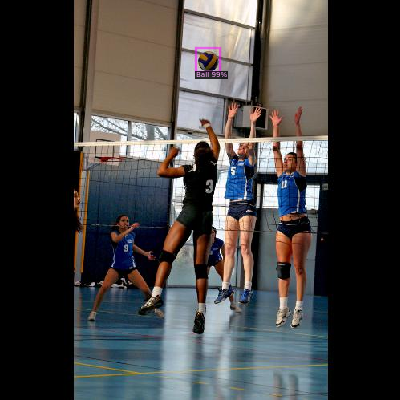

In [ ]:
for d in random.sample(dataset_dicts2, 3):
  im = cv2.imread(d["file_name"])    
  outputs = predictor(im)
  print(outputs)
  v = Visualizer(im[:, :, ::-1],
                  metadata=volleyball_easy_train_metadata, 
                  scale=0.8,
  )
  # print(outputs['proposals'][0])
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::-1])

## Czas inferencji

In [ ]:
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.24,fps:4.11


##Wyniki predyktora na "prostym" datasecie

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("volleyball_easy_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_easy_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 15:01:12 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/volleyball_easy/test/_annotations.coco.json
[09/18 15:01:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 15:01:12 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[09/18 15:01:12 d2.data.common]: Serialized dataset takes 0.03 MiB
[09/18 15:01:12 d2.evaluation.evaluator]: Start inference on 100 batches
[09/18 15:01:15 d2.evaluation.evaluator]: Inference done 11/100. Dataloading: 0.0014 s/iter. Inference: 0.2350 s/iter. Eval: 0.0003 s/iter. Total: 0.2367 s/iter. ETA=0:00:21
[09/18 15:01:20 d2.evaluation.evaluator]: Inference done 32/100. Dataloading: 0.0020 s/iter. Inference: 0.2357 s/iter. Eval: 0.0003 s/iter. Total: 0.2381 s/iter. ETA=0:00:16
[09/18 15:01:25 d2.evaluation.evaluator]: Inference done 54/100. Dataloading: 0.0021 s/iter. Infe

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

##Sprawdzenie skuteczności detektora na realistycznych przykładach z "trudnego" datasetu

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("volleyball_difficult_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_difficult_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 15:01:40 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
[09/18 15:01:41 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    Ball    | 43           |
|            |              |
[09/18 15:01:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 15:01:41 d2.data.common]: Serializing 51 elements to byte tensors and concatenating them all ...
[09/18 15:01:41 d2.data.common]: Serialized dataset takes 0.01 MiB
[09/18 15:01:41 d2.evaluation.evaluator]: Start inference on 51 batches
[09/18 15:01:45 d2.evaluation.evaluator]: Inference done 11/51. Dataloading: 0.0018 s/iter. Inference: 0.3507 s/iter. Eval: 0.0003 s/iter. Total: 0.3528 s/iter. ETA=0:00:14
[09/18 15:01:50 d2.evaluation.evaluator]: Inference done 26/51. Data

**Trenowanie na obrazkach z openimages nie wystarczy do wytrenowania sieci na nasze potrzeby**

In [ ]:
os.rename('/content/output/model_final.pth','/content/output/model_final_easy.pth')

## Trenowanie modelu na "trudnym" datasecie

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("volleyball_difficult_train",)
cfg.DATASETS.TEST = ('volleyball_difficult_test',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final_easy.pth")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.002
cfg.SOLVER.MAX_ITER = 4000
cfg.MODEL.RETINANET.NUM_CLASSES = 1


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)


In [ ]:
trainer.train()

[09/18 15:05:51 d2.engine.train_loop]: Starting training from iteration 0
[09/18 15:06:22 d2.utils.events]:  eta: 1:40:42  iter: 19  total_loss: 0.2441  loss_cls: 0.1462  loss_box_reg: 0.09506  time: 1.5113  data_time: 0.0250  lr: 3.9962e-05  max_mem: 2276M
[09/18 15:06:50 d2.utils.events]:  eta: 1:39:58  iter: 39  total_loss: 0.5904  loss_cls: 0.3685  loss_box_reg: 0.262  time: 1.4675  data_time: 0.0090  lr: 7.9922e-05  max_mem: 2276M
[09/18 15:07:19 d2.utils.events]:  eta: 1:39:27  iter: 59  total_loss: 0.6101  loss_cls: 0.32  loss_box_reg: 0.3323  time: 1.4578  data_time: 0.0118  lr: 0.00011988  max_mem: 2276M
[09/18 15:07:48 d2.utils.events]:  eta: 1:38:46  iter: 79  total_loss: 0.6022  loss_cls: 0.3071  loss_box_reg: 0.263  time: 1.4573  data_time: 0.0089  lr: 0.00015984  max_mem: 2278M
[09/18 15:08:17 d2.utils.events]:  eta: 1:38:08  iter: 99  total_loss: 0.6039  loss_cls: 0.2932  loss_box_reg: 0.2852  time: 1.4486  data_time: 0.0110  lr: 0.0001998  max_mem: 2278M
[09/18 15:08:46

In [ ]:
os.rename('/content/output/model_final.pth','/content/output/model_final_difficult_easy.pth')

In [ ]:
from google.colab import files
files.download('/content/output/model_final_difficult_easy.pth') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final_difficult_easy.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5  # set the testing threshold for this model
cfg.DATASETS.TEST = ("volleyball_difficult_test", )
predictor = DefaultPredictor(cfg)

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("volleyball_difficult_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_difficult_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 16:43:50 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
[09/18 16:43:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 16:43:50 d2.data.common]: Serializing 51 elements to byte tensors and concatenating them all ...
[09/18 16:43:50 d2.data.common]: Serialized dataset takes 0.01 MiB
[09/18 16:43:50 d2.evaluation.evaluator]: Start inference on 51 batches
[09/18 16:43:54 d2.evaluation.evaluator]: Inference done 11/51. Dataloading: 0.0017 s/iter. Inference: 0.3553 s/iter. Eval: 0.0004 s/iter. Total: 0.3574 s/iter. ETA=0:00:14
[09/18 16:43:59 d2.evaluation.evaluator]: Inference done 25/51. Dataloading: 0.0024 s/iter. Inference: 0.3558 s/iter. Eval: 0.0004 s/iter. Total: 0.3588 s/iter. ETA=0:00:09
[09/18 16:44:04 d2.evaluation.evaluator]: Inference done 39/51. Dataloading: 0.0025 s/iter. Infer

**Stwierdzono zdecydowaną poprawę rezultatów**

## Wizualizacja

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[918.5298, 243.8866, 933.5333, 258.9046]], device='cuda:0')), scores: tensor([0.8389], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


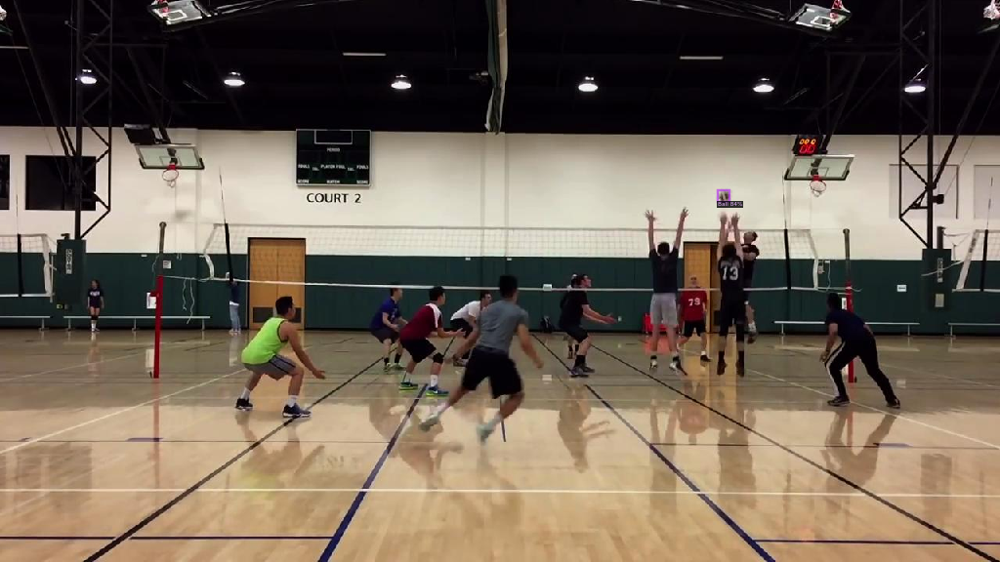

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[968.0849,  29.3355, 990.9495,  59.6599]], device='cuda:0')), scores: tensor([0.6504], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


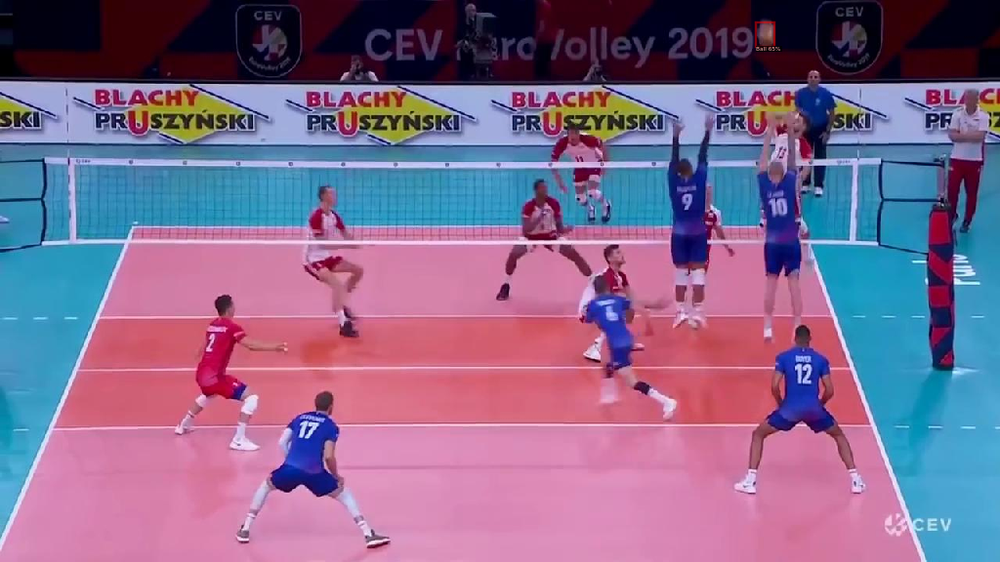

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[368.7467,  62.9589, 412.2671, 101.4304]], device='cuda:0')), scores: tensor([0.9982], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


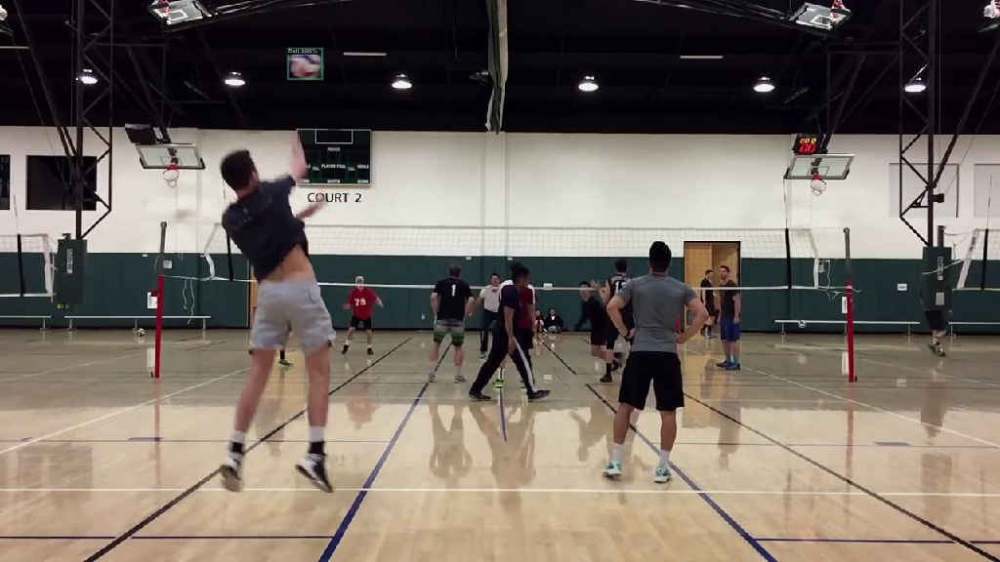

In [ ]:
for d in random.sample(dataset_dicts3, 3):
  im = cv2.imread(d["file_name"])    
  outputs = predictor(im)
  print(outputs)
  v = Visualizer(im[:, :, ::-1],
                  metadata=volleyball_easy_train_metadata, 
                  scale=0.8,
  )
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
# Look at training curves in tensorboard:
%reload_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 727), started 1:43:57 ago. (Use '!kill 727' to kill it.)

<IPython.core.display.Javascript object>